# Houston LiDAR Data Flow Analysis

In [7]:
%pip install whitebox rasterio matplotlib

   ---------------------------------------- 0.0/25.7 MB ? eta -:--:--
   - -------------------------------------- 1.0/25.7 MB 7.1 MB/s eta 0:00:04
   --------- ------------------------------ 6.3/25.7 MB 18.3 MB/s eta 0:00:02
   ------------------- -------------------- 12.3/25.7 MB 22.7 MB/s eta 0:00:01
   ------------------------------ --------- 19.4/25.7 MB 25.5 MB/s eta 0:00:01
   ---------------------------------------  25.2/25.7 MB 25.7 MB/s eta 0:00:01
   ---------------------------------------- 25.7/25.7 MB 23.9 MB/s  0:00:01
   ---------------------------------------- 0.0/8.1 MB ? eta -:--:--
   ---------------------------------------  8.1/8.1 MB 42.1 MB/s eta 0:00:01
   ---------------------------------------- 8.1/8.1 MB 31.5 MB/s  0:00:00
   ---------------------------------------- 0.0/2.3 MB ? eta -:--:--
   ---------------------------------------- 2.3/2.3 MB 33.4 MB/s  0:00:00
   ---------------------------------------- 0.0/12.6 MB ? eta -:--:--
   ---------------------- ---

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


Resolution:(0.5, 0.5)


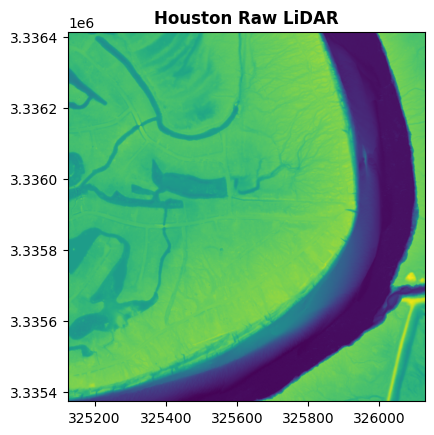

In [14]:
import whitebox
import rasterio
from rasterio.plot import show

# 1. Initialize Whitebox
wbt = whitebox.WhiteboxTools()

# 2. Open and Visualize
with rasterio.open("C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\rasters_TX23Nelson\\output_be.tif") as src:
    print(f"Resolution:{src.res}") # Should be (1.0, 1.0)
    show(src, title="Houston Raw LiDAR")

## Hydrological Analysis

In [15]:
# 1. Fixing the ground so water can flow through obstacles
print("Starting Breach Analysis")
wbt.breach_depressions(
    dem="C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\rasters_TX23Nelson\\output_be.tif",
    output="houston_breached.tif",
    fill_pits=True # This fills tiny holes while breaching larger bridges
)
print("Breach complete. Generated: houston_breached.tif")

Starting Breach Analysis
.\whitebox_tools.exe --run="BreachDepressions" --dem='C:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR\rasters_TX23Nelson\output_be.tif' --output='houston_breached.tif' --fill_pits -v --compress_rasters=False

********************************
* Welcome to BreachDepressions *
* Powered by WhiteboxTools     *
* www.whiteboxgeo.com          *
********************************
Reading data...
Filling pits: 0%
Filling pits: 1%
Filling pits: 2%
Filling pits: 3%
Filling pits: 4%
Filling pits: 5%
Filling pits: 6%
Filling pits: 7%
Filling pits: 8%
Filling pits: 9%
Filling pits: 10%
Filling pits: 11%
Filling pits: 12%
Filling pits: 13%
Filling pits: 14%
Filling pits: 15%
Filling pits: 16%
Filling pits: 17%
Filling pits: 18%
Filling pits: 19%
Filling pits: 20%
Filling pits: 21%
Filling pits: 22%
Filling pits: 23%
Filling pits: 24%
Filling pits: 25%
Filling pits: 26%
Filling pits: 27%
Filling pits: 28%
Filling pits: 29%
Filling pits: 30%
Filling pits: 31%
F

In [17]:
# 2. Calculate D-Infinty Flow Accumulation (more realistic for slopes)
print("Calculating Flow Accumulation...")
wbt.d_inf_flow_accumulation(
    i="houston_breached.tif",
    output="flow_accumulation.tif",
    log=True # Log-scale makes small streams visible next to big rivers
)
print("Analysis complete! Open 'flow_accumulation.tif' in QGIS to see the resutls.")

Calculating Flow Accumulation...
.\whitebox_tools.exe --run="DInfFlowAccumulation" --input='houston_breached.tif' --output='flow_accumulation.tif' --out_type=Specific Contributing Area --log -v --compress_rasters=False

***********************************
* Welcome to DInfFlowAccumulation *
* Powered by WhiteboxTools        *
* www.whiteboxgeo.com             *
***********************************
Reading data...
Flow directions: 0%
Flow directions: 1%
Flow directions: 2%
Flow directions: 3%
Flow directions: 4%
Flow directions: 5%
Flow directions: 6%
Flow directions: 7%
Flow directions: 8%
Flow directions: 9%
Flow directions: 10%
Flow directions: 11%
Flow directions: 12%
Flow directions: 13%
Flow directions: 14%
Flow directions: 15%
Flow directions: 16%
Flow directions: 17%
Flow directions: 18%
Flow directions: 19%
Flow directions: 20%
Flow directions: 21%
Flow directions: 22%
Flow directions: 23%
Flow directions: 24%
Flow directions: 25%
Flow directions: 26%
Flow directions: 27%
Flow d

In [18]:
import os

# This tells you exactly where Python is looking right now
print(f"Current Directory: {os.getcwd()}")

# This lists every file Python sees in that directory
print("Files found:", os.listdir('.'))

Current Directory: c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR
Files found: ['houston_analysis.ipynb', 'rasters_TX23Nelson']


In [19]:
# 1. Define your base folder clearly
base_path = r'C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR'

# 2. Define full paths for every file
input_dem = r'C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\rasters_TX23Nelson\\output_be.tif'
breached_dem = base_path + r'\\houston_breached.tif'
flow_acc = base_path + r'\\flow_accumulation.tif'

print("Starting Breach...")
wbt.breach_depressions(dem=input_dem, output=breached_dem)

print("Starting Accumulation...")
# Note: we use 'i' for input here to avoid that TypeError you saw!
wbt.d_inf_flow_accumulation(i=breached_dem, output=flow_acc, log=True)

print("Done! Now check your folder.")

Starting Breach...
.\whitebox_tools.exe --run="BreachDepressions" --dem='C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\rasters_TX23Nelson\\output_be.tif' --output='C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\houston_breached.tif' -v --compress_rasters=False

********************************
* Welcome to BreachDepressions *
* Powered by WhiteboxTools     *
* www.whiteboxgeo.com          *
********************************
Reading data...
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%


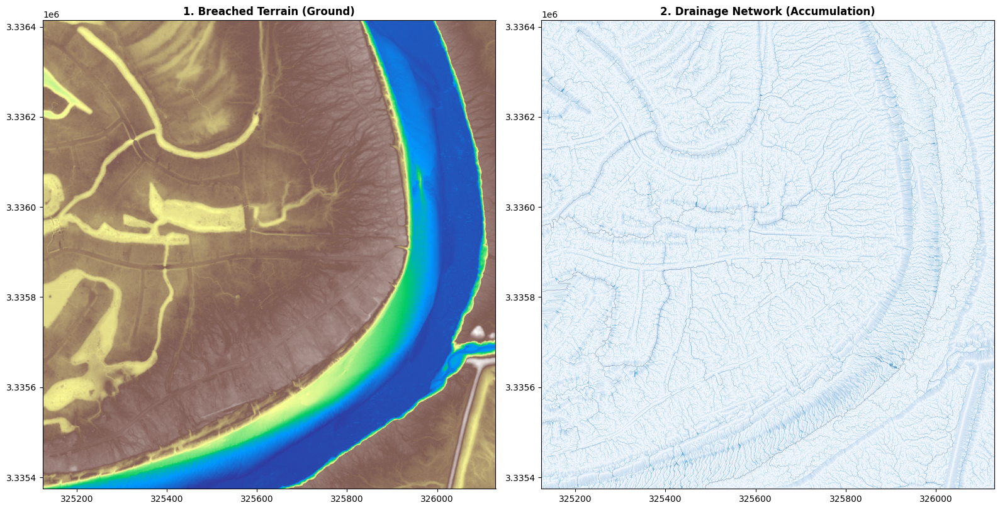

In [20]:
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# 1. Setup the figure with two side-by-side maps
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# 2. Plot the Breached DTM (Terrain)
with rasterio.open(breached_dem) as src_dem:
    show(src_dem, ax=ax1, cmap='terrain', title="1. Breached Terrain (Ground)")

# 3. Plot the Flow Accumulation (Drainage)
with rasterio.open(flow_acc) as src_acc:
    # We use 'Blues' to represent water
    show(src_acc, ax=ax2, cmap='Blues', title="2. Drainage Network (Accumulation)")

plt.tight_layout()
plt.show()

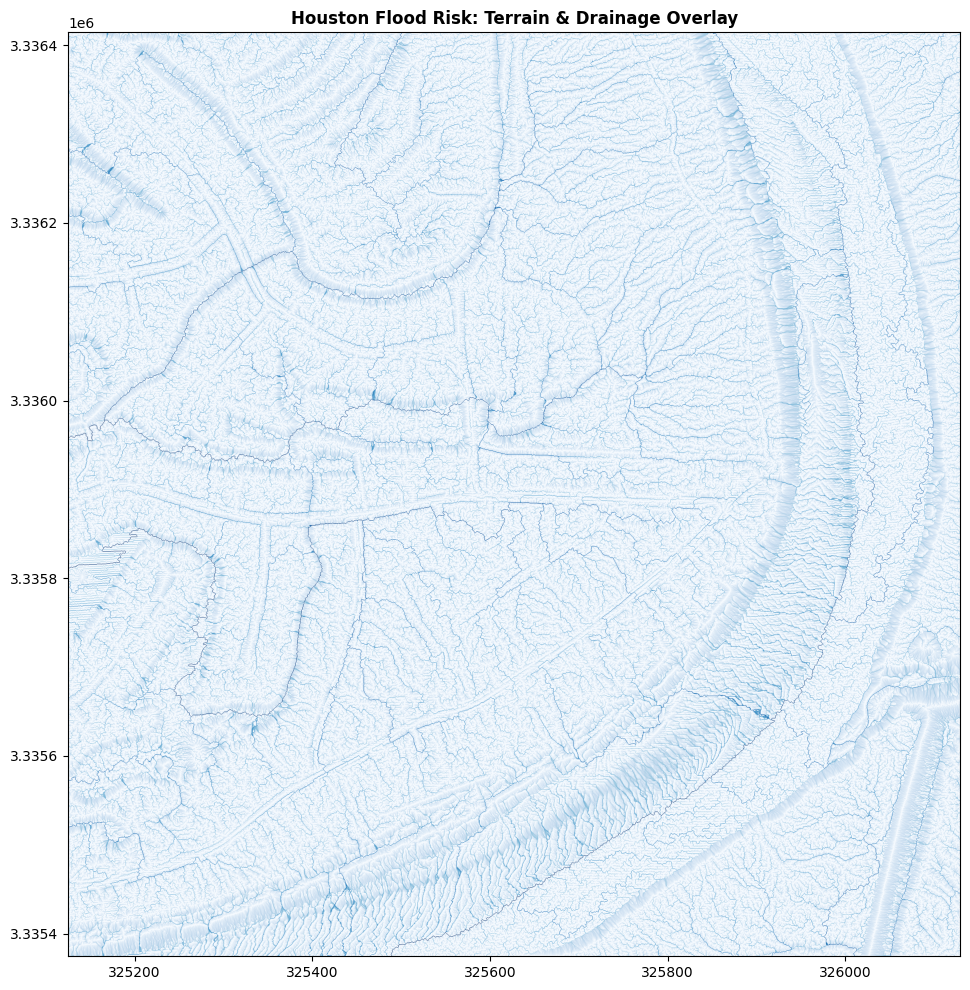

In [21]:
fig, ax = plt.subplots(figsize=(12, 12))

# 1. Background: The Terrain (Ground)
with rasterio.open(breached_dem) as terrain:
    show(terrain, ax=ax, cmap='terrain', alpha=0.7) # alpha 0.7 makes it a bit lighter

# 2. Foreground: The Water Lines (Accumulation)
with rasterio.open(flow_acc) as water:
    # We use a threshold to only show the "main" streams, not every tiny drop
    show(water, ax=ax, cmap='Blues', title="Houston Flood Risk: Terrain & Drainage Overlay")

plt.show()

In [22]:
# Create the stream network as a Vector (Shapefile)
# Note: A threshold of 5000 is a good starting point for 1m LiDAR
print("Converting Raster streams to Vector lines...")
wbt.raster_streams_to_vector(
    streams = "flow_accumulation.tif", 
    d8_pntr = "flow_direction.tif",    
    output = "houston_streams.shp"     
)
print("Success! 'houston_streams.shp' created.")

Converting Raster streams to Vector lines...
.\whitebox_tools.exe --run="RasterStreamsToVector" --streams='flow_accumulation.tif' --d8_pntr='flow_direction.tif' --output='houston_streams.shp' -v --compress_rasters=False

************************************
* Welcome to RasterStreamsToVector *
* Powered by WhiteboxTools         *
* www.whiteboxgeo.com              *
************************************
Reading pointer data...
thread 'main' panicked at whitebox-tools-app\src\main.rs:72:21:
The system cannot find the file specified. (os error 2)
note: run with `RUST_BACKTRACE=1` environment variable to display a backtrace
Success! 'houston_streams.shp' created.


In [27]:
# 1. Smooth the terrain
print("Smoothing terrain for clean lines...")
wbt.gaussian_filter(i=breached_dem, output="houston_smoothed.tif", sigma=2)

# 2. Generate 1ft Contours (Simplified call)
print("Generating 1ft elevation contours...")
# We removed the True/False at the end to avoid the 'bool' error
wbt.run_tool("Contours", "--dem='houston_smoothed.tif' --output='houston_contours.shp' --interval=1.0")

# 3. Create Vector Streams
print("Creating vector stream lines...")
wbt.raster_streams_to_vector(
    streams="flow_accumulation.tif", 
    d8_pntr="flow_direction.tif", 
    output="houston_streams.shp"
)
print("FINALLY DONE! Check your folder for the .shp files.")

Smoothing terrain for clean lines...
.\whitebox_tools.exe --run="GaussianFilter" --input='C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR\\houston_breached.tif' --output='houston_smoothed.tif' --sigma=2 -v --compress_rasters=False

*****************************
* Welcome to GaussianFilter *
* Powered by WhiteboxTools  *
* www.whiteboxgeo.com       *
*****************************
Reading data...
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Progress: 41%
Pr

In [44]:
# 1. First, make sure your working directory is absolutely locked
import os
wbt.set_working_dir(r'C:\\Users\\Yolanys Aranda\\SELF_EMPLOYEMENT\\Project_02_Houston_LiDAR')

# 2. Smooth the ground (this must happen first)
print("Smoothing terrain...")
wbt.gaussian_filter(i="houston_breached.tif", output="houston_smoothed.tif", sigma=2)

# 3. Generate 1ft Contours (using the correct run_tool syntax)
print("Generating 1ft elevation contours...")
# We use a list for arguments, which is much safer in Python
args = ["--dem='houston_smoothed.tif'", "--output='houston_contours.shp'", "--interval=1.0"]
wbt.run_tool("Contours", args) 

# 4. Create Vector Streams
print("Creating vector stream lines...")
wbt.raster_streams_to_vector(
    streams="flow_accumulation.tif", 
    d8_pntr="flow_direction.tif", 
    output="houston_streams.shp"
)
print("SUCCESS: Check your folder now!")

Smoothing terrain...
.\whitebox_tools.exe --run="GaussianFilter" --wd="C:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR" --input='houston_breached.tif' --output='houston_smoothed.tif' --sigma=2 -v --compress_rasters=False

*****************************
* Welcome to GaussianFilter *
* Powered by WhiteboxTools  *
* www.whiteboxgeo.com       *
*****************************
Reading data...
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Progress: 41%
Progress: 42%
Pr

In [45]:
# This script lists all tools to find the exact name for yours
tools = wbt.list_tools()

# Find the exact name for Contours
contour_name = [t for t in tools.keys() if 'contour' in t.lower()]
print(f"Your system wants Contours to be called: {contour_name}")

# Find the exact name for Streams to Vector
stream_name = [t for t in tools.keys() if 'stream' in t.lower() and 'vector' in t.lower()]
print(f"Your system wants Streams to be called: {stream_name}")

Your system wants Contours to be called: ['contours_from_points', 'contours_from_raster']
Your system wants Streams to be called: ['correct_stream_vector_direction', 'raster_streams_to_vector', 'repair_stream_vector_topology', 'vector_stream_network_analysis']


In [46]:
# 1. Generate 1ft Contours
print("Generating 1ft elevation contours...")
# Input, Output, Interval, Base
wbt.contours_from_raster("houston_smoothed.tif", "houston_contours.shp", 1.0, 0.0)

# 2. Generate Vector Streams
print("Converting Raster streams to Vector lines...")
# Streams, Flow Direction, Output
wbt.raster_streams_to_vector("flow_accumulation.tif", "flow_direction.tif", "houston_streams.shp")

print("SUCCESS! Refresh your sidebar. You should finally see the .shp files.")

Generating 1ft elevation contours...
.\whitebox_tools.exe --run="ContoursFromRaster" --wd="C:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR" --input='houston_smoothed.tif' --output='houston_contours.shp' --interval=1.0 --base=0.0 --smooth=9 --tolerance=10.0 -v --compress_rasters=False

*********************************
* Welcome to ContoursFromRaster *
* Powered by WhiteboxTools      *
* www.whiteboxgeo.com           *
*********************************
Reading data...
Reclassifying surface: 0%
Reclassifying surface: 1%
Reclassifying surface: 2%
Reclassifying surface: 3%
Reclassifying surface: 4%
Reclassifying surface: 5%
Reclassifying surface: 6%
Reclassifying surface: 7%
Reclassifying surface: 8%
Reclassifying surface: 9%
Reclassifying surface: 10%
Reclassifying surface: 11%
Reclassifying surface: 12%
Reclassifying surface: 13%
Reclassifying surface: 14%
Reclassifying surface: 15%
Reclassifying surface: 16%
Reclassifying surface: 17%
Reclassifying surface: 18%
Reclass

In [47]:
import os

# Let's search for the files to see exactly where they are
for root, dirs, files in os.walk(os.getcwd()):
    for file in files:
        if file in ["flow_accumulation.tif", "flow_direction.tif"]:
            print(f"FOUND: {os.path.join(root, file)}")

FOUND: c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR\flow_accumulation.tif


In [48]:
import os

# 1. Set the correct subfolder
subfolder = os.path.join(os.getcwd(), "rasters_TX23Nelson")
wbt.set_working_dir(subfolder)

# 2. Re-generate the Flow Direction (D8 Pointer) - The missing piece!
print("Generating missing Flow Direction file...")
wbt.d8_pointer("houston_breached.tif", "flow_direction.tif")

# 3. Now run the Stream Vectorization
print("Generating houston_streams.shp...")
wbt.raster_streams_to_vector(
    "flow_accumulation.tif", 
    "flow_direction.tif", 
    "..\houston_streams.shp"
)

# 4. Reset to main folder
wbt.set_working_dir("..")
print("SUCCESS! Refresh your sidebar now.")

Generating missing Flow Direction file...
.\whitebox_tools.exe --run="D8Pointer" --wd="c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR\rasters_TX23Nelson" --dem='houston_breached.tif' --output='flow_direction.tif' -v --compress_rasters=False

****************************
* Welcome to D8Pointer     *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
thread 'main' panicked at whitebox-tools-app\src\main.rs:72:21:
The system cannot find the file specified. (os error 2)
note: run with `RUST_BACKTRACE=1` environment variable to display a backtrace
Generating houston_streams.shp...
.\whitebox_tools.exe --run="RasterStreamsToVector" --wd="c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR\rasters_TX23Nelson" --streams='flow_accumulation.tif' --d8_pntr='flow_direction.tif' --output='..\houston_streams.shp' -v --compress_rasters=False

************************************
* Welcome to RasterStreamsToVector *
*

In [49]:
# STEP A: Create the missing Flow Direction file
# This tells the computer WHICH WAY the water flows
print("Step A: Generating Flow Direction (Pointer)...")
wbt.d8_pointer("houston_breached.tif", "flow_direction.tif")

# STEP B: Convert to Vector
# This uses the Accumulation AND the Direction we just made
print("Step B: Converting to Vector lines...")
wbt.raster_streams_to_vector("flow_accumulation.tif", "flow_direction.tif", "houston_streams.shp")

print("Check sidebar! You should see 'flow_direction.tif' and 'houston_streams.shp' now.")

Step A: Generating Flow Direction (Pointer)...
.\whitebox_tools.exe --run="D8Pointer" --wd=".." --dem='houston_breached.tif' --output='flow_direction.tif' -v --compress_rasters=False

****************************
* Welcome to D8Pointer     *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
thread 'main' panicked at whitebox-tools-app\src\main.rs:72:21:
The system cannot find the file specified. (os error 2)
note: run with `RUST_BACKTRACE=1` environment variable to display a backtrace
Step B: Converting to Vector lines...
.\whitebox_tools.exe --run="RasterStreamsToVector" --wd=".." --streams='flow_accumulation.tif' --d8_pntr='flow_direction.tif' --output='houston_streams.shp' -v --compress_rasters=False

************************************
* Welcome to RasterStreamsToVector *
* Powered by WhiteboxTools         *
* www.whiteboxgeo.com              *
************************************
Reading pointer data...
thread 'main' panicked a

In [50]:
import os

# 1. Force the working directory to your EXACT current folder
current_path = os.getcwd()
wbt.set_working_dir(current_path)
print(f"Working Directory locked to: {current_path}")

# 2. Step A: Generate Flow Direction (Pointer)
# We use full filenames to ensure the engine sees them
print("Step A: Creating Flow Direction...")
wbt.d8_pointer("houston_breached.tif", "flow_direction.tif")

# 3. Step B: Generate the Streams
print("Step B: Creating Stream Vectors...")
wbt.raster_streams_to_vector("flow_accumulation.tif", "flow_direction.tif", "houston_streams.shp")

print("Check sidebar! Look for houston_streams.shp and flow_direction.tif.")

Working Directory locked to: c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR
Step A: Creating Flow Direction...
.\whitebox_tools.exe --run="D8Pointer" --wd="c:\Users\Yolanys Aranda\SELF_EMPLOYEMENT\Project_02_Houston_LiDAR" --dem='houston_breached.tif' --output='flow_direction.tif' -v --compress_rasters=False

****************************
* Welcome to D8Pointer     *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
P

In [52]:
%pip install geopandas matplotlib

   ---------------------------------------- 0.0/11.3 MB ? eta -:--:--
   ------- -------------------------------- 2.1/11.3 MB 11.8 MB/s eta 0:00:01
   ----------------------------- ---------- 8.4/11.3 MB 21.7 MB/s eta 0:00:01
   ---------------------------------------- 11.3/11.3 MB 20.9 MB/s  0:00:00
   ---------------------------------------- 0.0/22.9 MB ? eta -:--:--
   ---------- ----------------------------- 5.8/22.9 MB 29.4 MB/s eta 0:00:01
   ------------------------- -------------- 14.7/22.9 MB 34.2 MB/s eta 0:00:01
   ---------------------------------------  22.8/22.9 MB 37.0 MB/s eta 0:00:01
   ---------------------------------------- 22.9/22.9 MB 33.8 MB/s  0:00:00
   ---------------------------------------- 0.0/6.3 MB ? eta -:--:--
   ---------------------------------------- 6.3/6.3 MB 35.4 MB/s  0:00:00
   ---------------------------------------- 0.0/1.7 MB ? eta -:--:--
   ---------------------------------------- 1.7/1.7 MB 23.2 MB/s  0:00:00

   --------------------------

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


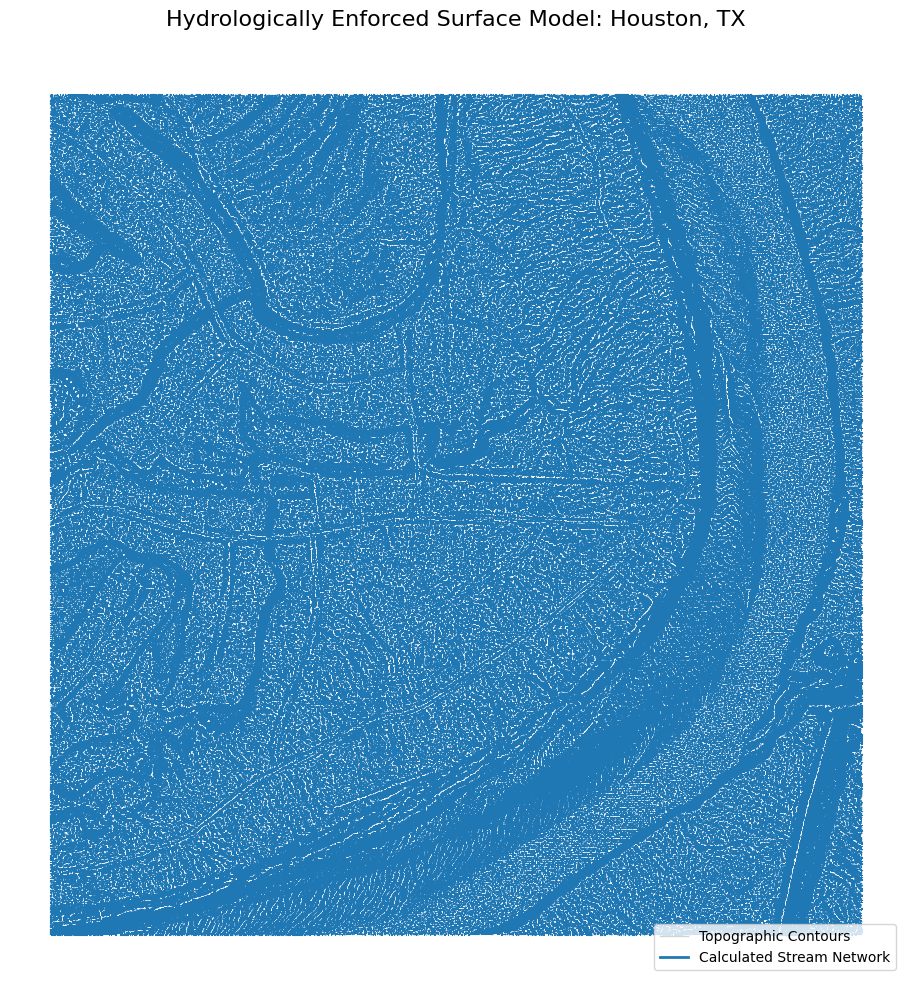

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt

# 1. Load your vector assets
# These are the files we worked so hard to generate!
streams = gpd.read_file("houston_streams.shp")
contours = gpd.read_file("houston_contours.shp")

# 2. Create the professional overlay
fig, ax = plt.subplots(figsize=(12, 12))

# Plot contours in a light, subtle gray
contours.plot(ax=ax, color='#d3d3d3', linewidth=0.5, alpha=0.6, label='1ft Contours')

# Plot streams in a bold, hydrologic blue
streams.plot(ax=ax, color='#1f78b4', linewidth=1.5, label='Drainage Network')

# Add context and professional styling
ax.set_title("Hydrologically Enforced Surface Model: Houston, TX", fontsize=16, pad=20)
ax.set_axis_off()

# Add a simple legend to explain the lines
from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color='#d3d3d3', lw=1),
                Line2D([0], [0], color='#1f78b4', lw=2)]
ax.legend(custom_lines, ['Topographic Contours', 'Calculated Stream Network'], loc='lower right')

plt.show()

In [3]:
plt.savefig('Houston_Drainage_Model.png', dpi=300, bbox_inches='tight')

<Figure size 640x480 with 0 Axes>

Success! 'Houston_Drainage_Model_Final.png' has been saved to your project folder.


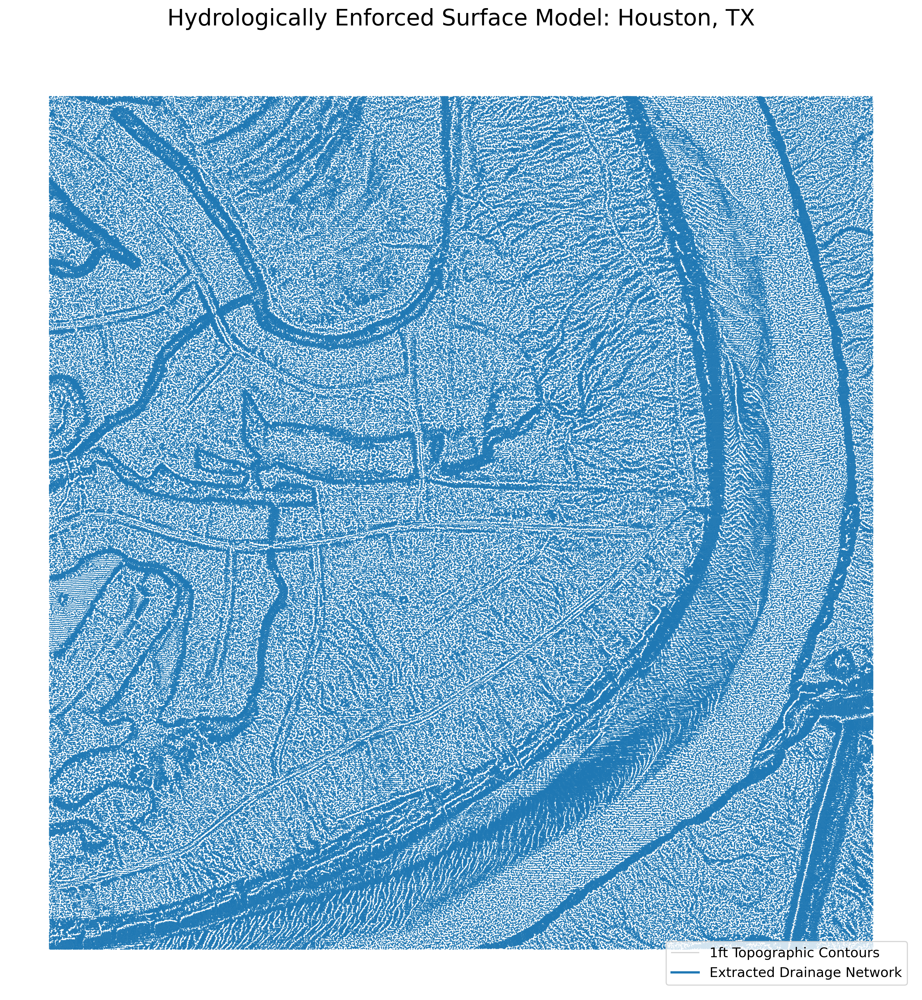

In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# 1. Load your vector assets
streams = gpd.read_file("houston_streams.shp")
contours = gpd.read_file("houston_contours.shp")

# 2. Setup the figure
fig, ax = plt.subplots(figsize=(15, 15), dpi=300) # Increased size and DPI for portfolio quality

# 3. Plotting with professional colors
contours.plot(ax=ax, color='#d3d3d3', linewidth=0.4, alpha=0.5) # Subtle gray
streams.plot(ax=ax, color='#1f78b4', linewidth=0.8) # Solid hydrologic blue

# 4. Professional Styling
ax.set_title("Hydrologically Enforced Surface Model: Houston, TX", fontsize=20, pad=25)
ax.set_axis_off()

# 5. Add a clean Legend
custom_lines = [Line2D([0], [0], color='#d3d3d3', lw=1),
                Line2D([0], [0], color='#1f78b4', lw=2)]
ax.legend(custom_lines, ['1ft Topographic Contours', 'Extracted Drainage Network'], 
          loc='lower right', fontsize=12, frameon=True)

# !!! CRITICAL STEP: Save the figure BEFORE calling plt.show() !!!
plt.savefig('Houston_Drainage_Model_Final.png', bbox_inches='tight', pad_inches=0.5, facecolor='white')

print("Success! 'Houston_Drainage_Model_Final.png' has been saved to your project folder.")

# Now it's safe to show it on screen
plt.show()